#AEIF-Dataset Tutorial

- Website: https://aeif-dataset.github.io/
- GitHub: https://github.com/MarcelVSHNS/AEIF-Dataset

This tutorial demonstrates how to use the AEIF-Dataset. Visit the [AEIF-Dataset Website](https://bwsyncandshare.kit.edu/s/NLMELDyk8iZ6Ycj) to download the full dataset.

To use, open this notebook in [Colab](https://colab.research.google.com).

## Installation

In [ ]:
# Install the package to easily access and manage the AEIF-Dataset.
#!pip install aeif-dataset

# Uncomment the following line to select a specific version if needed.
# !pip install --upgrade aeif-dataset==0.8.4

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.4/119.4 kB 7.3 MB/s eta 0:00:00


## Download Data

In [ ]:
# Download two sample record files, each containing three frames.
# These sample records will help you quickly understand how to work with the dataset.
#!if [ ! -f "example_record_1.4mse" ]; then wget https://bwsyncandshare.kit.edu/s/WiToGpB5Wr8PDpQ/download/example_record_1.4mse; fi
#!if [ ! -f "example_record_2.4mse" ]; then wget https://bwsyncandshare.kit.edu/s/YwesoXYZ8izYSJW/download/example_record_2.4mse; fi

--2024-10-10 12:47:06--  https://bwsyncandshare.kit.edu/s/WiToGpB5Wr8PDpQ/download/example_record_1.4mse
Resolving bwsyncandshare.kit.edu (bwsyncandshare.kit.edu)... 141.3.135.129, 2a00:1398:b::8d03:8781
Connecting to bwsyncandshare.kit.edu (bwsyncandshare.kit.edu)|141.3.135.129|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/octet-stream]
Saving to: ‘example_record_1.4mse’

example_record_1.4m     [        <=>         ] 231.88M  28.4MB/s    in 8.7s    

2024-10-10 12:47:16 (26.6 MB/s) - ‘example_record_1.4mse’ saved [243139577]

--2024-10-10 12:47:16--  https://bwsyncandshare.kit.edu/s/YwesoXYZ8izYSJW/download/example_record_2.4mse
Resolving bwsyncandshare.kit.edu (bwsyncandshare.kit.edu)... 141.3.135.129, 2a00:1398:b::8d03:8781
Connecting to bwsyncandshare.kit.edu (bwsyncandshare.kit.edu)|141.3.135.129|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [application/octet-stream]
Saving to: ‘example_

## Read the Data

The dataset is organized into multiple frames distributed across several files. One Frame consists of all the sensor data aquired during a 100ms period with the according metadata. The detailed structure of a single frame can be accessed [here](https://github.com/MarcelVSHNS/AEIF-Dataset/blob/main/aeifdataset/data/README.md).

You can use the `Dataloader` class to open and manage all the files within a specified directory. To access a single file directly, use the `DataRecord` class. Both `Dataloader` and `DataRecord` are iterable, allowing you to easily loop through frames or records.



In [ ]:
import aeifdataset as ad
from aeifdataset import Dataloader, DataRecord
from pprint import pprint  # For structured output

# Access the whole dataset
# The Dataloader class loads and manages multiple .4mse files from the specified directory.
dataset = Dataloader("/content/")

# Access a single Data Record
# Each DataRecord corresponds to a file, which contains multiple frames.
example_record_1 = dataset[0]
# Alternatively; access by name:
example_record_1 = DataRecord("/content/example_record_1.4mse")

# Access a single frame
# A frame contains sensor data and metadata for a 100ms period.
example_frame = example_record_1[0]

# Iterate through Data Records and Frames
frames = []
for datarecord in dataset:
    for frame in datarecord:
        frames.append(frame)

# Access the third frame in the dataset
# This frame will be used as an example to demonstrate data access.
frame = frames[2]
print('Frame Metadata:')
pprint(vars(frame))  # Using pprint for a more readable output


Frame Metadata:
{'frame_id': 1016,
 'timestamp': Decimal('1727426142799683960'),
 'tower': <aeifdataset.data.agent.Tower object at 0x7e4af5aa95a0>,
 'vehicle': <aeifdataset.data.agent.Vehicle object at 0x7e4af5b03640>,
 'version': '0.7.5'}


Here are some examples, how to acces the data inside a Frame. For detailed information refer to the [Documentation](https://github.com/MarcelVSHNS/AEIF-Dataset/blob/main/aeifdataset/data/README.md).

In [ ]:
# Access vehicle metadata
vehicle_metadata = frame.vehicle.info

# Access vehicle camera "STEREO_LEFT" rectified image
stereo_left_image = frame.vehicle.cameras.STEREO_LEFT

# Access tower camera "VIEW_1" raw image with corresponding metadata
view_1_raw_image = frame.tower.cameras.VIEW_1._image_raw
view_1_metadata = frame.tower.cameras.VIEW_1.info

# Access tower "UPPER_PLATFORM" lidar points and timestamp of the pointcloud
upper_platform_lidar_points = frame.tower.lidars.UPPER_PLATFORM
upper_platform_lidar_timestamp = frame.tower.lidars.UPPER_PLATFORM.timestamp

# Access vehicle IMU data
imu_data = frame.vehicle.IMU

# Access tower GNSS data
tower_gnss_data = frame.tower.GNSS

# Access dynamics velocity and metadata
dynamics_velocity = frame.vehicle.DYNAMICS.velocity
dynamics_info = frame.vehicle.DYNAMICS.info

# The data can be printed to view key information contained in the object.
# For a comprehensive list of all available fields, refer to the documentation.
print(view_1_metadata)

CameraInformation(
    name=view_1,
    model_name=a2A1920-51gcPRO,
    camera_mtx=
    [[1.750e+03, 0.000e+00, 9.273e+02],
     [0.000e+00, 1.750e+03, 5.667e+02],
     [0.000e+00, 0.000e+00, 1.000e+00]],
    distortion_mtx=
    [-2.578e-01,  1.063e-01,  1.686e-04,  4.817e-04,  0.000e+00],
    extrinsic=Pose(
        xyz=[ 0.297,  0.22 , -0.54 ],
        rpy=[-1.799,  0.05 , -1.168]
    )
)


### Visualize Camera Images

You can easily visualize the camera images captured by the vehicle or tower. Below is an example of how to visualize images from all cameras in a frame.

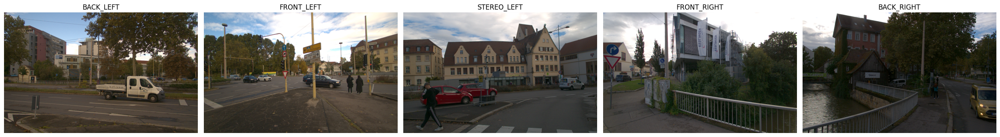

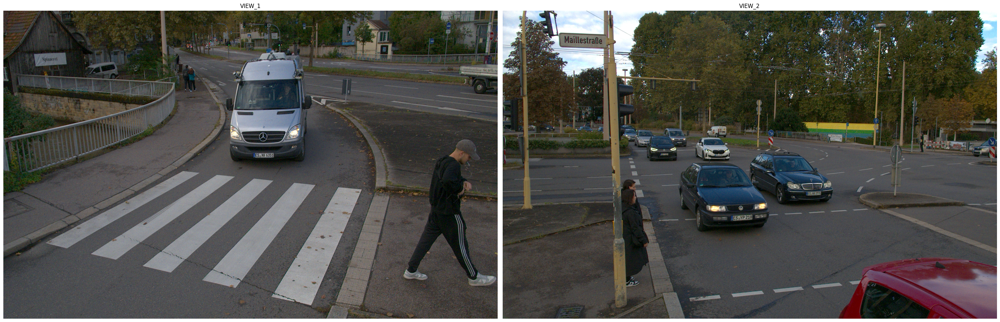

In [ ]:
import matplotlib.pyplot as plt

# Iterate over agents in the frame (vehicle and tower)
# Each agent contains its own set of cameras. We'll visualize all the camera images.
for agent in frame:
    cameras = agent.cameras
    num_cameras = len(cameras)

    # Create a figure to display the camera images
    plt.figure(figsize=(30, 10))

    # Iterate over the cameras of the current agent
    for i, (camera_name, camera) in enumerate(cameras):
        #setting up subplots for displaying images
        plt.subplot(1, num_cameras, i + 1)

        # Access and display the image captured by the camera
        plt.imshow(camera)
        plt.title(camera_name)
        plt.axis('off')

    # Display the images for the current agent
    plt.tight_layout()
    plt.show()

In [ ]:
# A single Image can be accessed and visualised through predefined
# plt.imshow(stereo_left_image) or
# plt.imshow(frame.vehicle.cameras.STEREO_LEFT)

# Outside of Jupyter Notebooks images can also be visualized by simply calling:
# stereo_left_image.show()

### Visualize LiDAR Pointcloud

The following example shows how to visualize a single 3D point cloud that we defined previously as `upper_platform_lidar_points`.

In [ ]:
import plotly.graph_objects as go
import numpy as np

# Convert structured NumPy array to a regular 3D NumPy array with contiguous memory.
xyz_points = np.stack((upper_platform_lidar_points['x'], upper_platform_lidar_points['y'], upper_platform_lidar_points['z']), axis=-1)

def visualize_lidar_points(points, points_color=None, title="LiDAR Point Cloud", size=2, opacity=0.6):
    '''
    This function provides utility to visualize a pointcloud in jupyter notebooks. Outside of Jupyter Notebooks lidar pointclouds can also be visualized by simply calling:
    ad.show_points(upper_platform_lidar_points)
    '''
    if points_color is None:
        color = points[:, 2]
        marker_color = dict(
            size=size,
            color=color,
            colorscale='viridis',
            opacity=opacity
        )
    else:
        #this will be used later in the colab
        marker_color = dict(
            size=size,
            color=['rgb({}, {}, {})'.format(*rgb) for rgb in points_color],
            opacity=opacity
        )

    # Create a plotly 3D scatter plot
    fig = go.Figure(data=[go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=marker_color
    )])

    # Update the layout for better visualization
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            aspectmode='data'
        ),
        width=800,
        height=700,
        title=title
    )

    fig.show()

visualize_lidar_points(xyz_points, title='Upper Platform LiDAR Point Cloud')

You can iterate over the LiDAR sensors of a specific agent in the same way as with the cameras.

In [ ]:
# Minimal Example to demonstrate iterative processing of the lidar data
for lidar_name, lidar in frame.vehicle.lidars:
    print(f'Data from {lidar_name} LiDAR')

Data from LEFT LiDAR
Data from TOP LiDAR
Data from RIGHT LiDAR


## Utility Functions

The developer kit provides a variety of utility functions to facilitate common tasks when working with the dataset. These include:

- **Image Processing:** Functions for rectifying images, computing stereo disparity, and saving images with or without metadata.
- **Transformation:** The `Transformation` class handles 3D transformations, making it easy to transform points between coordinate frames or back to the origin.
- **Sensor Fusion:** Tools to project LiDAR points onto camera images, extract RGB values for 3D points, and merge point clouds from multiple LiDAR sensors.
- **Visualization:** Methods to display LiDAR data on images, visualize 3D point clouds, and show disparity maps.

### Image Processing

Below are examples of how to use the utility functions for image processing.

In [ ]:
# Example: Rectifying a raw image using available metadata
# This function takes the raw image and its corresponding metadata to generate a rectified image.

rect_img = ad.get_rect_img((view_1_raw_image, view_1_metadata))

In [ ]:
# Example: Generating disparity and depth maps using stereo camera images
# These functions use left and right stereo images to calculate a disparity map and depth map.

stereo_left = frame.vehicle.cameras.STEREO_LEFT
stereo_right = frame.vehicle.cameras.STEREO_RIGHT

# Retrieve disparity map from stereo images
disparity_map = ad.get_disparity_map(stereo_left, stereo_right)

# Generate a depth map from stereo images
depth_map = ad.get_depth_map(stereo_left, stereo_right)

# Alternatively, convert a disparity map to a depth map using camera parameters
depth_map = ad.disparity_to_depth(disparity_map, stereo_right.info)

Note: Depth map calculation is experimental

In [ ]:
# Example: Saving and loading images with metadata
# The following code demonstrates saving an image along with its metadata, as well as loading it later.

camera = frame.tower.cameras.VIEW_1
output_path = '/content/'
camera_name = camera.info.name.lower()
input_path = '/content/2024-09-27_10-35-42.802116919_view_1.png'

# Save one image with metadata. Optional suffix and metadata can be provided.
ad.save_image(camera.image, output_path, suffix=f'_{camera_name}', metadata=camera.info)

# Load the saved image along with its metadata
image = ad.load_image_with_metadata(input_path)

# Save all images from a frame, automatically organizing them into subdirectories by camera name.
ad.save_all_images_in_frame(frame, output_path, create_subdir=True)

### Transformation

This section demonstrates how to use the `Transformation` class for 3D transformations.


In [ ]:
# Example: Working with LiDAR transformations
# The following code demonstrates creating transformation objects for LiDAR sensors and performing transformations between them.

lidar_1 = frame.tower.lidars.VIEW_1
lidar_2 = frame.tower.lidars.VIEW_2

# Create a Transformation object for lidar_1 (transforms to the agent's origin)
lidar_1_transformation = ad.get_transformation(lidar_1)
print(lidar_1_transformation)

# Retrieve the transformation matrix
lidar_1_transformation_matrix = lidar_1_transformation.transformation_mtx

# Example: Calculate the transformation between two sensors (lidar_1 and lidar_2)
# First, get the transformation for lidar_2
lidar_2_transformation = ad.get_transformation(lidar_2)

# Get the inverse of the lidar_2 transformation (to go from the agent's origin to lidar_2)
lidar_2_inverse = lidar_2_transformation.invert_transformation()

# Combine transformations to compute lidar_1 -> lidar_2 transformation
lidar_1_to_2_transformation = lidar_1_transformation.combine_transformation(lidar_2_inverse)
print(lidar_1_to_2_transformation)

Transformation at lidar_view_1 to lidar_upper_platform/os_sensor,
  translation=[0.095, 0.068, -0.378],
  rotation=[-0.351, 0.044, -1.137]

Transformation at lidar_view_1 to lidar_view_2,
  translation=[-0.120, -0.273, 0.231],
  rotation=[-0.321, -0.188, 1.453]



In [ ]:
# Example: Transforming LiDAR points to the agent's origin
# This function transforms the 3D points from the LiDAR's local coordinate system to the origin of the agent (vehicle or tower).

points_in_origin = ad.transform_points_to_origin(lidar_1)

### Sensor Fusion

The following section shows how to project LiDAR points onto camera images and perform sensor fusion tasks.


In [ ]:
# Example: Projecting LiDAR points onto camera images
# This function projects 3D LiDAR points onto the 2D camera image plane.

lidar_1 = frame.tower.lidars.VIEW_1
camera_1 = frame.tower.cameras.VIEW_1

# Project LiDAR points onto the camera's 2D image plane
pts_3d, proj_2d = ad.get_projection(lidar_1, camera_1)

# Perform the same projection but also retrieve RGB values of the points from the camera image
pts_3d, proj_2d, color = ad.get_rgb_projection(lidar_1, camera_1)

# Example: Fuse point clouds from multiple LiDAR sensors
# Combine all the LiDAR points from an agent (vehicle or tower) into a single point cloud
fused_vehicle_pointcloud = ad.combine_lidar_points(frame.vehicle)

# Alternatively, combine points from selected LiDAR sensors
fused_tower_pointcloud = ad.combine_lidar_points(lidar_1, lidar_2)

Note: Currently, projections are only supported within the same agent (e.g., within the vehicle or tower). Transformations between different agents (vehicle to tower) are not yet available.

### Visualization Functions

The following example demonstrates how to visualize LiDAR points projected onto camera images, with each LiDAR visualized in a different color.

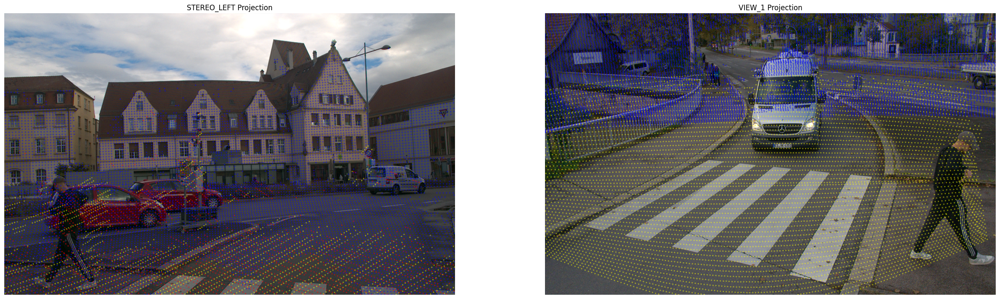

In [ ]:
# Example: Visualizing LiDAR points projected onto camera images
# This example visualizes all vehicle LiDARs projected onto the stereo_left image, and all tower LiDARs projected onto the view_1 image.

camera_tower = frame.tower.cameras.VIEW_1
camera_vehicle = frame.vehicle.cameras.STEREO_LEFT

lidars_with_colors_vehicle = [
    (frame.vehicle.lidars.LEFT, 'yellow'),
    (frame.vehicle.lidars.RIGHT, 'red'),
    (frame.vehicle.lidars.TOP, 'blue')
]

lidars_with_colors_tower = [
    (frame.tower.lidars.VIEW_1, 'yellow'),
    (frame.tower.lidars.VIEW_2, 'red'),
    (frame.tower.lidars.UPPER_PLATFORM, 'blue')
]

fig, axs = plt.subplots(1, 2, figsize=(30, 10))

def plot_projection(ax, camera, lidars_with_colors, title):
    # Project LiDAR points onto the camera's 2D image plane and recieve the image with the the points plotted onto it.
    # If you want to print your own set of points onto an image you can use ad.plot_points_on_image().
    proj_img = ad.get_projection_img(camera, *lidars_with_colors)
    ax.imshow(proj_img)
    ax.set_title(title)
    ax.axis('off')

plot_projection(axs[0], camera_vehicle, lidars_with_colors_vehicle, 'STEREO_LEFT Projection')
plot_projection(axs[1], camera_tower, lidars_with_colors_tower, 'VIEW_1 Projection')

plt.show()

The following snippet visualizes all available camera images with all available LiDAR projections. The color of the LiDAR points indicates their distance from the agent's origin.

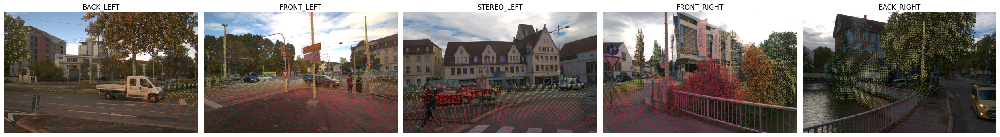

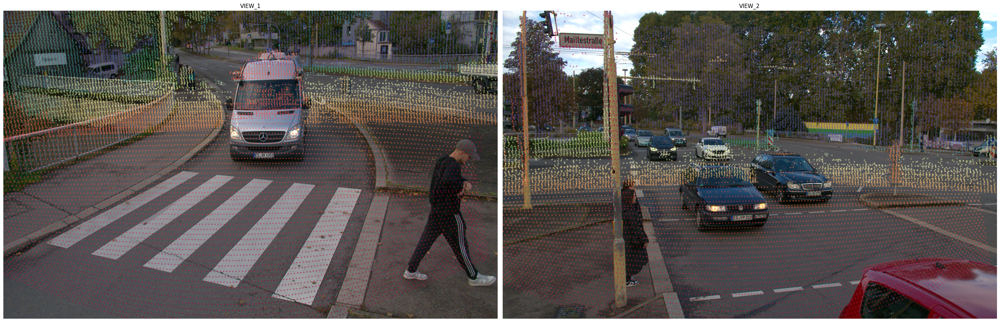

In [ ]:
# Example: Visualizing LiDAR projections onto all available camera images
# This example iterates through all the cameras of each agent (vehicle and tower),
# projecting LiDAR points onto the corresponding camera images and displaying the results.

for agent in frame:
    cameras = agent.cameras
    num_cameras = len(cameras)

    plt.figure(figsize=(30, 10))

    # Iterate through the cameras and project the LiDAR points onto each image
    for i, (camera_name, camera) in enumerate(cameras):
        lidars = [lidar for lidar_name, lidar in agent.lidars]

        plt.subplot(1, num_cameras, i + 1)
        projection = ad.get_projection_img(camera, *lidars)
        plt.imshow(projection)
        plt.title(camera_name)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

The next example shows how to visualize the LiDAR data from the vehicle with their corresponding RGB values attached.

In [ ]:
# Example: Visualizing LiDAR data with attached RGB values
# This example shows how to visualize the vehicle's LiDAR points with RGB values extracted from the corresponding camera image.

points = []
points_color = []

for _, camera in frame.vehicle.cameras:
    for _, lidar in frame.vehicle.lidars:
        pts_3d, proj_2d, color = ad.get_rgb_projection(lidar, camera)
        points.append(ad.transform_points_to_origin((pts_3d, lidar.info)))
        points_color.append(color)

points = np.vstack(points)
points_color = np.vstack(points_color)

# Visualize the fused point cloud with attached RGB values
visualize_lidar_points(points, points_color, size=4, title='Fused Vehicle RGB Pointcloud')

# Outside of Jupyter Notebooks, use ad.show_points() to visualize the point cloud directly

The following example demonstrates how to generate and visualize a colored depth map using stereo camera images.

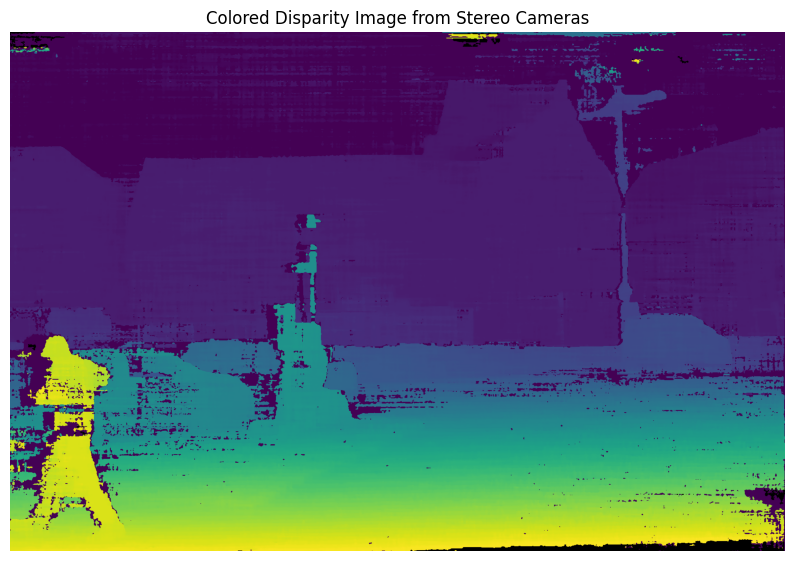

In [ ]:
# Example: Visualizing a colored depth map from stereo cameras
# This example retrieves a colored disparity map from stereo images and displays it.

# Generate a colored disparity map
stereo_image = ad.get_colored_stereo_image(stereo_left, stereo_right)

# Display the colored disparity image
plt.figure(figsize=(10, 8))
plt.imshow(stereo_image)
plt.title("Colored Disparity Image from Stereo Cameras")
plt.axis('off')
plt.show()